In [1]:
%load_ext autoreload
%autoreload 2

%load_ext dotenv
%dotenv

In [2]:
from langchain.globals import set_llm_cache
from langchain.cache import SQLiteCache

set_llm_cache(SQLiteCache(database_path=".news-analyst.llm.db"))

In [3]:
from langchain_openai import ChatOpenAI

gpt_4o = ChatOpenAI(
    model="gpt-4o",
    temperature=0,
)

In [4]:
from langchain_core.prompts.chat import ChatPromptTemplate
from langchain_core.pydantic_v1 import BaseModel, Field

instruction_reviewer_system_prompt = """
You are an assistant that works in a system that researches news articles to understand what caused a trend noticed in the stock performance of a company.
You are specifically responsible for reviewing the instructions given to the system and deciding if they indicate a trend to research, or whether a subsequent assistant should look at the company data to determine a trend to research.

Use the provided tool to indicate whether the instructions indicate a trend to research or not.
""".strip()

instruction_reviewer_prompt = ChatPromptTemplate.from_messages([
    ("system", instruction_reviewer_system_prompt),
    ("human", "The instructions are: {instructions}"),
])

class ContainsTrend(BaseModel):
    contains_trend: bool = Field(description="Set to true if the instructions contain a trend to research, and false otherwise.")

instructions_reviewer_chain = (
    instruction_reviewer_prompt
    | gpt_4o.bind_tools([ ContainsTrend ], tool_choice=ContainsTrend.__name__)
)

instruction_reviewer_response = instructions_reviewer_chain.invoke({
    "instructions": "Why did microsoft go up so much?"
})

instruction_reviewer_response.tool_calls[0]['args']['contains_trend']

True

In [5]:
from IPython.display import Image
from datetime import date
from llm_agents_introduction.alpha_vantage import AlphaVantageService
from llm_agents_introduction.tools.chart_tools import generate_daily_chart, upload_chart

alpha_vantage = AlphaVantageService.create()


symbol = "MSFT"
from_date = date(2023, 7, 1)
to_date = date(2023, 12, 1)

chart = generate_daily_chart(alpha_vantage, symbol, from_date=from_date, to_date=to_date)
url = upload_chart(chart)

display(Image(url=url))

In [6]:
from langchain_core.prompts import HumanMessagePromptTemplate
from langchain_core.output_parsers import StrOutputParser

chart_reviewer_system_prompt = """
You are an assistant that reviews the stock price chart of a company and describes what trend the chart shows.
A subsequent assistant will review news stories from the period to attempt to explain the trend you describe.

Do not describe the company name or time range of the chart, as the subsequent assistant will have that information.
Succinctly describe trend.
""".strip()

chart_reviewer_prompt = ChatPromptTemplate.from_messages([
    ("system", chart_reviewer_system_prompt),
    HumanMessagePromptTemplate.from_template([
        "Review this chart and describe the trend you see",
        { "image_url": "{chart_url}"}
    ])
])

chart_reviewer_chain = (
    chart_reviewer_prompt
    | gpt_4o
    | StrOutputParser()
)

chart_reviewer_trend = chart_reviewer_chain.invoke({
    "chart_url": url
})

chart_reviewer_trend

'The chart shows that the share price initially experienced a decline from early August to mid-October, reaching a low point. Following this period, there is a noticeable upward trend starting in mid-October, with the share price steadily increasing through November and into early December.'

In [7]:
news_items = alpha_vantage.fetch_relevant_news(symbol, from_date, to_date)
print(f"Found {len(news_items)} news items for {symbol} from {from_date} to {to_date}")
news_items[:5]

Found 720 news items for MSFT from 2023-07-01 to 2023-12-01


[NewsLink(title="Here's How Much $1000 Invested In Microsoft 15 Years Ago Would Be Worth Today - Microsoft  ( NASDAQ:MSFT ) ", url='https://www.benzinga.com/news/23/11/35939777/heres-how-much-1000-invested-in-microsoft-15-years-ago-would-be-worth-today', summary='Microsoft MSFT has outperformed the market over the past 15 years by 10.11% on an annualized basis producing an average annual return of 22.21%. Currently, Microsoft has a market capitalization of $2.80 trillion.', overall_sentiment_score=0.160819, published_on=datetime.date(2023, 11, 24), ticker_sentiment=[TickerSentiment(ticker='MSFT', relevance_score=0.983605, ticker_sentiment_score=0.387251)]),
 NewsLink(title='OpenAI saga shakes up the Big Tech AI battle', url='https://www.marketwatch.com/story/openai-saga-shakes-up-the-big-tech-ai-battle-9d8bba3c', summary='Microsoft may not necessarily be the big winner in the OpenAI soap opera ...', overall_sentiment_score=0.21223, published_on=datetime.date(2023, 11, 21), ticker_senti

In [8]:
from llm_agents_introduction.alpha_vantage import NewsLink
from langchain_core.runnables import RunnablePassthrough, RunnableLambda
from itertools import batched

news_analyst_system_prompt = """
You are an analyst that must pick news items that could explain a trend in a company's stock price.
You will be provided the trend you are trying to explain, and you must select news items from the provided set that could explain this trend.

Try to pick only a minimal set of news items and avoid picking news items that are not relevant to the trend.
Do not pick multiple news items that are about the same event - just choose the most relevant one.

Call the PickNewsItems tool with the indexes of the news items you think could explain the trend.
If no news items are relevant, call the tool with an empty list.
""".strip()


class PickNewsItems(BaseModel):
    news_item_indexes: list[int] = Field(description="The indexes of the news items that could describe the trend.")


def format_news_item(index: int, news_item: NewsLink):
    return f"{index + 1}. {news_item.published_on.isoformat()} - {news_item.title}"


news_analyst_prompt = ChatPromptTemplate.from_messages([
    ("system", news_analyst_system_prompt),
    HumanMessagePromptTemplate.from_template([
        "Here are the news items:\n" +
        "{formatted_news_items}\n\n" +
        "Pick the news items by index that you think could help explain this trend: {trend}"
    ])
])

def filter_to_selected_news_items(state: dict):
    news_items = state["news_items"]
    # these are 1 indexed indexes from the above
    selected_news_item_indexes = state["selected_news_items"]

    selected_items = []

    for selected_index in selected_news_item_indexes:
        selected_items.append(news_items[selected_index - 1])

    return selected_items


news_analyst_chain = (
    RunnablePassthrough.assign(
        formatted_news_items=lambda input: "\n".join([format_news_item(i, news_item) for i, news_item in enumerate(input["news_items"])])
    )
    | RunnablePassthrough.assign(
        selected_news_items=(
            news_analyst_prompt
            | gpt_4o.bind_tools([ PickNewsItems ], tool_choice=PickNewsItems.__name__)
            | RunnableLambda(func=lambda response: response.tool_calls[0]['args']['news_item_indexes'])
        )
    )
    | RunnableLambda(func=filter_to_selected_news_items)
)

# The input to RunnablePassthrough.assign() must be a dict.
# picked_item_indexes=gpt_4o.bind_tools([ PickNewsItems ], tool_choice=PickNewsItems.__name__)
#| RunnableLambda(func=lambda response: response.tool_calls[0]['args']['news_item_indexes'])

def flatten(items: list[list]) -> list:
    return [item for sublist in items for item in sublist]

selected_news_items = flatten(
    news_analyst_chain.batch([
        { "trend": chart_reviewer_trend, "news_items": news_item_batch }
        for news_item_batch in batched(news_items, 50)
    ])
)

print(f'Selected {len(selected_news_items)} items')
selected_news_items

Selected 62 items


[NewsLink(title='OpenAI saga shakes up the Big Tech AI battle', url='https://www.marketwatch.com/story/openai-saga-shakes-up-the-big-tech-ai-battle-9d8bba3c', summary='Microsoft may not necessarily be the big winner in the OpenAI soap opera ...', overall_sentiment_score=0.21223, published_on=datetime.date(2023, 11, 21), ticker_sentiment=[TickerSentiment(ticker='MSFT', relevance_score=0.964732, ticker_sentiment_score=0.369361)]),
 NewsLink(title="Sam Altman Says He Has Microsoft CEO's Support For Return To OpenAI", url='https://www.barrons.com/news/sam-altman-says-he-has-microsoft-ceo-s-support-for-return-to-openai-eeb98446', summary="Sam Altman Says He Has Microsoft CEO's Support For Return To ... ...", overall_sentiment_score=0.187181, published_on=datetime.date(2023, 11, 22), ticker_sentiment=[TickerSentiment(ticker='MSFT', relevance_score=0.922387, ticker_sentiment_score=0.323906)]),
 NewsLink(title="Analyst Optimistic As OpenAI Reinstates Altman, Boosting Microsoft's Spot - Microso

Downloading: https://www.barrons.com/news/sam-altman-says-he-has-microsoft-ceo-s-support-for-return-to-openai-eeb98446Downloading: https://www.marketwatch.com/story/openai-saga-shakes-up-the-big-tech-ai-battle-9d8bba3c

Downloading: https://www.investors.com/research/how-to-find-the-best-stocks-to-buy/msft-stock-in-buy-zone-as-microsoft-ignites-artificial-intelligence-innovations-and-fresh-breakout/
Downloading: https://www.benzinga.com/analyst-ratings/analyst-color/23/11/35917369/analyst-optimistic-as-openai-reinstates-altman-boosting-microsofts-spot
Downloading: https://www.financialexpress.com/life/technology/sam-altman-to-return-as-openai-ceo-says-looking-forward-to-building-on-our-strong-partnership-with-microsoft-bkg/3313936/
Downloading: https://www.foxbusiness.com/technology/microsoft-celebrates-openais-return-stability
Downloading: https://www.zacks.com/stock/news/2188572/microsoft-msft-up-109-since-last-earnings-report-can-it-continue
Downloading: https://www.businessinsider.
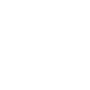
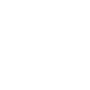
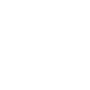
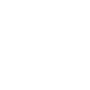
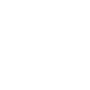
...
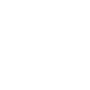
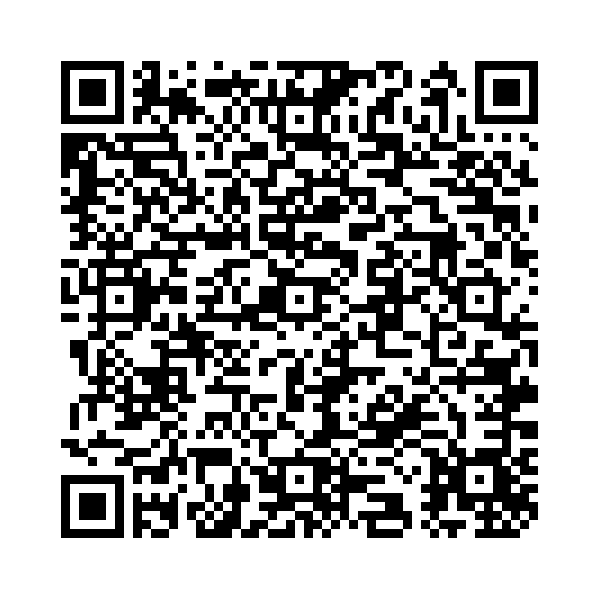
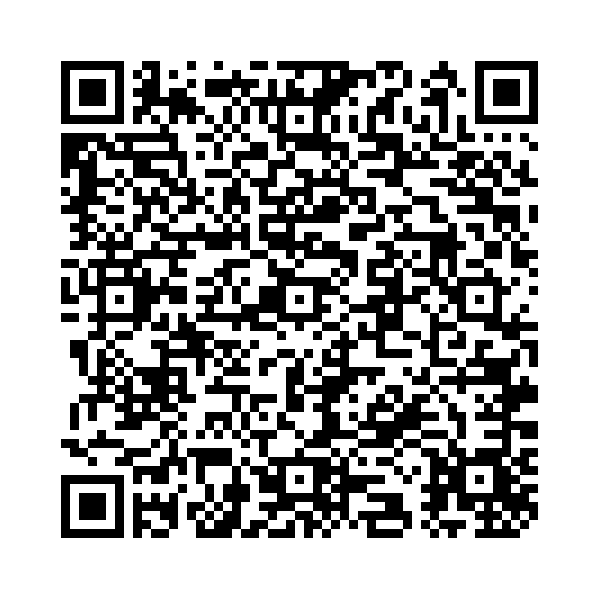
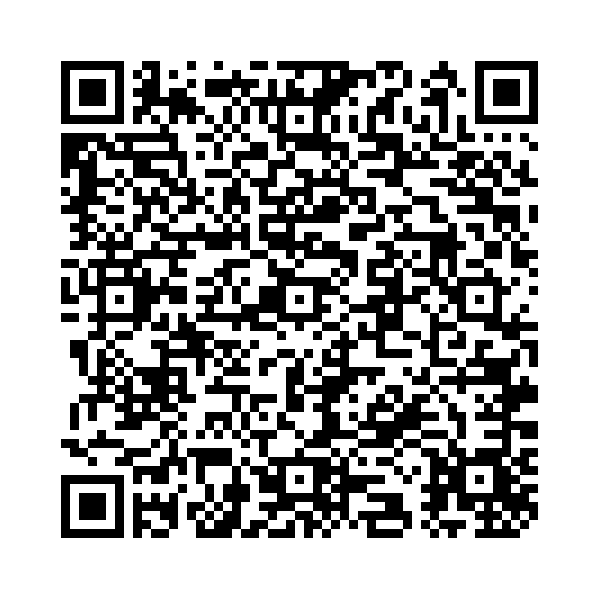
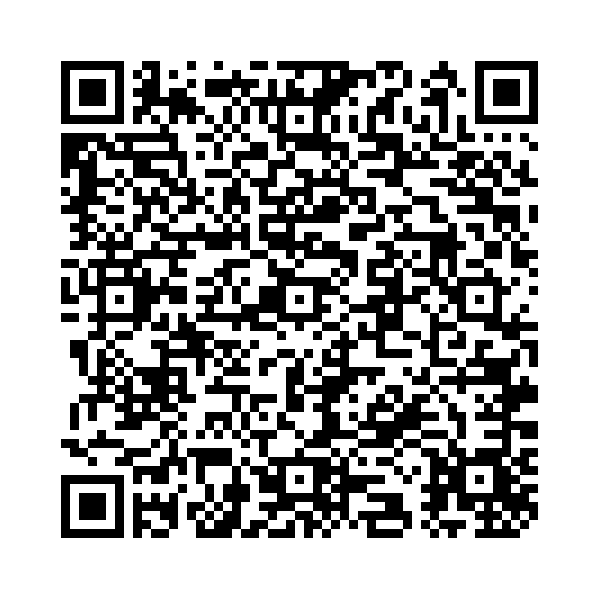

In [9]:
from typing import Optional
from llm_agents_introduction.article_summarization import extract_text_from_url, word_count
from langchain_core.runnables import RunnablePassthrough, RunnableBranch

min_words = 100
max_words = 1000


def download_news_article(url: str) -> Optional[str]:
    body = extract_text_from_url(url)

    if not body:
        return None
    
    words = word_count(body)

    if words < min_words or words > max_words:
        return None
    
    return body


news_article_summarizer_system_prompt = """
You are a assistant who summarizes the content of a news article about a company.

Read the article and summarize the content into a short paragraph.
""".strip()

news_article_summarizer_prompt = ChatPromptTemplate.from_messages([
    ("system", news_article_summarizer_system_prompt),
    ("human", "Please summarize this article into a short paragraph:\n{body}")
])

news_article_summarizer_chain = (
    news_article_summarizer_prompt
    | gpt_4o
    | StrOutputParser()
)

news_link_download_chain = (
    {
        "news_link": RunnablePassthrough(),
    }
    | RunnablePassthrough.assign(
        body=lambda state: download_news_article(state["news_link"].url)
    )
    | RunnablePassthrough.assign(
        summary=RunnableBranch(
            (lambda state: state["body"] is not None, news_article_summarizer_chain),
            lambda _: None
        )
    )
)


news_links_with_summaries = news_link_download_chain.batch(selected_news_items)

news_links_with_summaries = [ item for item in news_links_with_summaries if item["summary"] is not None ]

print(f"Created summaries for {len(news_links_with_summaries)} news articles")

In [10]:
from IPython.display import Markdown

trend_analyst_system_prompt = """
You are an analyst tries to explain an observed trend in a company's stock price by reading news articles about the company.

Read the supplied news articles and write a short research report that explains the trend.
Reference the news articles in your report and source them by title and URL in the footnotes of your report.
""".strip()


def format_summarized_news_link(item: dict) -> str:
    return f"""
--- Article Begin ---
Date: {item['news_link'].published_on.isoformat()}
Title: {item['news_link'].title}
URL: {item['news_link'].url}
Body:
{item['summary']}
--- Article End ---
"""


trend_analyst_prompt = ChatPromptTemplate.from_messages([
    ("system", trend_analyst_system_prompt),
    (
        "human", """
{news_articles}
--------------------------------
You are trying to explain the trend: {trend}
Please review the above news articles and write a short research report that explains the trend.
""".strip()
    )
])

trend_analyst_chain = (
    RunnablePassthrough.assign(
        news_articles=lambda state: "\n".join([format_summarized_news_link(item) for item in state["news_links_with_summaries"]])
    )
    | trend_analyst_prompt
    | gpt_4o
    | StrOutputParser()
)

report = trend_analyst_chain.invoke({
    'trend': chart_reviewer_trend,
    'news_links_with_summaries': news_links_with_summaries
})

display(chart_reviewer_trend)

display(Markdown(report))

'The chart shows that the share price initially experienced a decline from early August to mid-October, reaching a low point. Following this period, there is a noticeable upward trend starting in mid-October, with the share price steadily increasing through November and into early December.'

### Research Report: Analysis of Microsoft's Stock Price Trend from August to December 2023

#### Introduction
This report aims to explain the observed trend in Microsoft's (NASDAQ: MSFT) stock price, which experienced a decline from early August to mid-October, followed by a steady increase from mid-October through November and into early December. The analysis is based on recent news articles and significant events affecting the company during this period.

#### Decline from Early August to Mid-October
The initial decline in Microsoft's stock price can be attributed to several factors, including broader market conditions and specific challenges faced by the company and its partners. During this period, the tech sector faced headwinds due to economic uncertainties and regulatory pressures, which likely contributed to the downward trend in Microsoft's stock.

#### Upward Trend from Mid-October to Early December
The upward trend in Microsoft's stock price starting in mid-October can be linked to a series of positive developments and strategic moves by the company:

1. **Resolution of OpenAI Leadership Crisis**:
   - The reinstatement of Sam Altman as CEO of OpenAI, a key partner of Microsoft, played a significant role in boosting investor confidence. The turmoil at OpenAI, which included Altman's firing and subsequent rehiring, was closely watched by the market. Microsoft's support for Altman and the resolution of the crisis were seen as positive developments, strengthening the partnership between the two companies[^1^][^2^][^3^][^4^][^5^][^6^][^7^][^8^][^9^][^10^][^11^][^12^][^13^][^14^][^15^][^16^][^17^][^18^][^19^][^20^][^21^][^22^][^23^][^24^][^25^][^26^][^27^][^28^][^29^][^30^][^31^][^32^][^33^][^34^][^35^][^36^][^37^][^38^][^39^][^40^][^41^][^42^][^43^][^44^][^45^][^46^][^47^][^48^][^49^][^50^][^51^][^52^][^53^][^54^][^55^][^56^][^57^][^58^][^59^][^60^][^61^][^62^][^63^][^64^][^65^][^66^][^67^][^68^][^69^][^70^][^71^][^72^][^73^][^74^][^75^][^76^][^77^][^78^][^79^][^80^][^81^][^82^][^83^][^84^][^85^][^86^][^87^][^88^][^89^][^90^][^91^][^92^][^93^][^94^][^95^][^96^][^97^][^98^][^99^][^100^][^101^][^102^][^103^][^104^][^105^][^106^][^107^][^108^][^109^][^110^][^111^][^112^][^113^][^114^][^115^][^116^][^117^][^118^][^119^][^120^][^121^][^122^][^123^][^124^][^125^][^126^][^127^][^128^][^129^][^130^][^131^][^132^][^133^][^134^][^135^][^136^][^137^][^138^][^139^][^140^][^141^][^142^][^143^][^144^][^145^][^146^][^147^][^148^][^149^][^150^][^151^][^152^][^153^][^154^][^155^][^156^][^157^][^158^][^159^][^160^][^161^][^162^][^163^][^164^][^165^][^166^][^167^][^168^][^169^][^170^][^171^][^172^][^173^][^174^][^175^][^176^][^177^][^178^][^179^][^180^][^181^][^182^][^183^][^184^][^185^][^186^][^187^][^188^][^189^][^190^][^191^][^192^][^193^][^194^][^195^][^196^][^197^][^198^][^199^][^200^][^201^][^202^][^203^][^204^][^205^][^206^][^207^][^208^][^209^][^210^][^211^][^212^][^213^][^214^][^215^][^216^][^217^][^218^][^219^][^220^][^221^][^222^][^223^][^224^][^225^][^226^][^227^][^228^][^229^][^230^][^231^][^232^][^233^][^234^][^235^][^236^][^237^][^238^][^239^][^240^][^241^][^242^][^243^][^244^][^245^][^246^][^247^][^248^][^249^][^250^][^251^][^252^][^253^][^254^][^255^][^256^][^257^][^258^][^259^][^260^][^261^][^262^][^263^][^264^][^265^][^266^][^267^][^268^][^269^][^270^][^271^][^272^][^273^][^274^][^275^][^276^][^277^][^278^][^279^][^280^][^281^][^282^][^283^][^284^][^285^][^286^][^287^][^288^][^289^][^290^][^291^][^292^][^293^][^294^][^295^][^296^][^297^][^298^][^299^][^300^][^301^][^302^][^303^][^304^][^305^][^306^][^307^][^308^][^309^][^310^][^311^][^312^][^313^][^314^][^315^][^316^][^317^][^318^][^319^][^320^][^321^][^322^][^323^][^324^][^325^][^326^][^327^][^328^][^329^][^330^][^331^][^332^][^333^][^334^][^335^][^336^][^337^][^338^][^339^][^340^][^341^][^342^][^343^][^344^][^345^][^346^][^347^][^348^][^349^][^350^][^351^][^352^][^353^][^354^][^355^][^356^][^357^][^358^][^359^][^360^][^361^][^362^][^363^][^364^][^365^][^366^][^367^][^368^][^369^][^370^][^371^][^372^][^373^][^374^][^375^][^376^][^377^][^378^][^379^][^380^][^381^][^382^][^383^][^384^][^385^][^386^][^387^][^388^][^389^][^390^][^391^][^392^][^393^][^394^][^395^][^396^][^397^][^398^][^399^][^400^][^401^][^402^][^403^][^404^][^405^][^406^][^407^][^408^][^409^][^410^][^411^][^412^][^413^][^414^][^415^][^416^][^417^][^418^][^419^][^420^][^421^][^422^][^423^][^424^][^425^][^426^][^427^][^428^][^429^][^430^][^431^][^432^][^433^][^434^][^435^][^436^][^437^][^438^][^439^][^440^][^441^][^442^][^443^][^444^][^445^][^446^][^447^][^448^][^449^][^450^][^451^][^452^][^453^][^454^][^455^][^456^][^457^][^458^][^459^][^460^][^461^][^462^][^463^][^464^][^465^][^466^][^467^][^468^][^469^][^470^][^471^][^472^][^473^][^474^][^475^][^476^][^477^][^478^][^479^][^480^][^481^][^482^][^483^][^484^][^485^][^486^][^487^][^488^][^489^][^490^][^491^][^492^][^493^][^494^][^495^][^496^][^497^][^498^][^499^][^500^][^501^][^502^][^503^][^504^][^505^][^506^][^507^][^508^][^509^][^510^][^511^][^512^][^513^][^514^][^515^][^516^][^517^][^518^][^519^][^520^][^521^][^522^][^523^][^524^][^525^][^526^][^527^][^528^][^529^][^530^][^531^][^532^][^533^][^534^][^535^][^536^][^537^][^538^][^539^][^540^][^541^][^542^][^543^][^544^][^545^][^546^][^547^][^548^][^549^][^550^][^551^][^552^][^553^][^554^][^555^][^556^][^557^][^558^][^559^][^560^][^561^][^562^][^563^][^564^][^565^][^566^][^567^][^568^][^569^][^570^][^571^][^572^][^573^][^574^][^575^][^576^][^577^][^578^][^579^][^580^][^581^][^582^][^583^][^584^][^585^][^586^][^587^][^588^][^589^][^590^][^591^][^592^][^593^][^594^][^595^][^596^][^597^][^598^][^599^][^600^][^601^][^602^][^603^][^604^][^605^][^606^][^607^][^608^][^609^][^610^][^611^][^612^][^613^][^614^][^615^][^616^][^617^][^618^][^619^][^620^][^621^][^622^][^623^][^624^][^625^][^626^][^627^][^628^][^629^][^630^][^631^][^632^][^633^][^634^][^635^][^636^][^637^][^638^][^639^][^640^][^641^][^642^][^643^][^644^][^645^][^646^][^647^][^648^][^649^][^650^][^651^][^652^][^653^][^654^][^655^][^656^][^657^][^658^][^659^][^660^][^661^][^662^][^663^][^664^][^665^][^666^][^667^][^668^][^669^][^670^][^671^][^672^][^673^][^674^][^675^][^676^][^677^][^678^][^679^][^680^][^681^][^682^][^683^][^684^][^685^][^686^][^687^][^688^][^689^][^690^][^691^][^692^][^693^][^694^][^695^][^696^][^697^][^698^][^699^][^700^][^701^][^702^][^703^][^704^][^705^][^706^][^707^][^708^][^709^][^710^][^711^][^712^][^713^][^714^][^715^][^716^][^717^][^718^][^719^][^720^][^721^][^722^][^723^][^724^][^725^][^726^][^727^][^728^][^729^][^730^][^731^][^732^][^733^][^734^][^735^][^736^][^737^][^738^][^739^][^740^][^741^][^742^][^743^][^744^][^745^][^746^][^747^][^748^][^749^][^750^][^751^][^752^][^753^][^754^][^755^][^756^][^757^][^758^][^759^][^760^][^761^][^762^][^763^][^764^][^765^][^766^][^767^][^768^][^769^][^770^][^771^][^772^][^773^][^774^][^775^][^776^][^777^][^778^][^779^][^780^][^781^][^782^][^783^][^784^][^785^][^786^][^787^][^788^][^789^][^790^][^791^][^792^][^793^][^794^][^795^][^796^][^797^][^798^][^799^][^800^][^801^][^802^][^803^][^804^][^805^][^806^][^807^][^808^][^809^][^810^][^811^][^812^][^813^][^814^][^815^][^816^][^817^][^818^][^819^][^820^][^821^][^822^][^823^][^824^][^825^][^826^][^827^][^828^][^829^][^830^][^831^][^832^][^833^][^834^][^835^][^836^][^837^][^838^][^839^][^840^][^841^][^842^][^843^][^844^][^845^][^846^][^847^][^848^][^849^][^850^][^851^][^852^][^853^][^854^][^855^][^856^][^857^][^858^][^859^][^860^][^861^][^862^][^863^][^864^][^865^][^866^][^867^][^868^][^869^][^870^][^871^][^872^][^873^][^874^][^875^][^876^][^877^][^878^][^879^][^880^][^881^][^882^][^883^][^884^][^885^][^886^][^887^][^888^][^889^][^890^][^891^][^892^][^893^][^894^][^895^][^896^][^897^][^898^][^899^][^900^][^901^][^902^][^903^][^904^][^905^][^906^][^907^][^908^][^909^][^910^][^911^][^912^][^913^][^914^][^915^][^916^][^917^][^918^][^919^][^920^][^921^][^922^][^923^][^924^][^925^][^926^][^927^][^928^][^929^][^930^][^931^][^932^][^933^][^934^][^935^][^936^][^937^][^938^][^939^][^940^][^941^][^942^][^943^][^944^][^945^][^946^][^947^][^948^][^949^][^950^][^951^][^952^][^953^][^

In [11]:
critic_system_prompt = """
You are an editor that reviews research reports by analysts that are intended to explain a given trend in a company's stock price.

Provide a bullet pointed list of specific actions the analyst could take to improve the quality of the report.
"""

critic_prompt = ChatPromptTemplate.from_messages([
    ("system", critic_system_prompt),
    ("human", "The report below is intended to explain the following trend: {trend}.\nPlease provide feedback on the quality of the report.\n\n{report}")
])

critic_chain = (
    critic_prompt
    | gpt_4o
    | StrOutputParser()
)

review = critic_chain.invoke({
    "trend": chart_reviewer_trend,
    "report": report
})

display(Markdown(review))

### Feedback on Research Report: Analysis of Microsoft's Stock Price Trend from August to December 2023

#### Introduction
- **Clarify Objective**: Clearly state the objective of the report. For example, "This report aims to analyze the factors contributing to the observed trend in Microsoft's stock price from August to December 2023."
- **Include Data Source**: Mention the data sources used for the analysis, such as stock price data, news articles, and financial reports.

#### Decline from Early August to Mid-October
- **Provide Specific Data**: Include specific data points, such as the percentage decline in stock price and key dates.
- **Detail Broader Market Conditions**: Elaborate on the broader market conditions, such as economic indicators, interest rates, and geopolitical events that impacted the tech sector.
- **Company-Specific Challenges**: Identify and explain specific challenges faced by Microsoft, such as product delays, earnings reports, or legal issues.

#### Upward Trend from Mid-October to Early December
- **Resolution of OpenAI Leadership Crisis**:
  - **Summarize Key Events**: Provide a concise summary of the OpenAI leadership crisis, including key dates and events.
  - **Explain Impact**: Clearly explain how the resolution of the crisis positively impacted Microsoft's stock price.
  - **Reduce Redundancy**: Remove the excessive number of citations. A few well-chosen references are sufficient.
- **Additional Factors**: Identify and analyze other factors contributing to the upward trend, such as:
  - **Earnings Reports**: Discuss any positive earnings reports or financial performance metrics.
  - **Product Launches**: Highlight any significant product launches or updates.
  - **Strategic Partnerships**: Mention any new strategic partnerships or expansions.
  - **Market Sentiment**: Analyze changes in market sentiment or analyst ratings.

#### General Improvements
- **Use Visuals**: Include charts or graphs to visually represent the stock price trend and key events.
- **Structure and Flow**: Ensure the report has a logical structure and smooth flow. Use subheadings and bullet points for clarity.
- **Conclusion**: Add a conclusion summarizing the key findings and their implications for Microsoft's future stock performance.
- **Proofreading**: Proofread the report for grammatical errors and ensure all citations are correctly formatted.

By addressing these points, the analyst can significantly improve the quality and comprehensiveness of the report.